Homework 5 — (15 points) - Music structure and song similarity
======
### What to hand in
You are to submit the following things for this homework:
1. A Jupyter notebook containing all code and output (figures and audio). I should be able to evaluate the file to reproduce all output. 
1. Any other data that we tell you to save to a file (e.g. audio files).

### How to hand it in
To submit your lab:
1. Compress all of the files specified into a .zip file. 
1. Name the file in the following manner, firstname_lastname_hw1.zip. For example, Bryan_Pardo_hw1.zip. 
1. Submit this .zip file via Canvas

<div style="text-align: center" class="alert alert-danger"><h3>CHECK CANVAS FOR DUE DATE</h3></div>

## Helpful reading for this homework - Chapters 4 and 7 in Fundamentals of Music Processing by Meinard Muller.

### Run this code block 1st, to import the needed packages

In [1]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath,math, scipy
from IPython.display import Audio
from IPython.display import HTML
 
# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline

def apply_style():
    """
	Useful styles for displaying graphs and audio elements.
	"""
    style = HTML("""
        <style>
            audio {
            width: 100% !important;
        }
        .output_png {
            text-align: center !important;
        }
        </style>
        """)
    IPython.display.display(style)
    
def audio(d, sr, ext = '.mp3'):
    """
	Embeds audio into notebook
	Parameters:
	   d: numpy array of audio data.
	   sr: sampling rate for the audio
	"""
    IPython.display.display(IPython.display.Audio(data=d, rate = sr))
    
apply_style()

<div class="alert alert-success">
<b>1. (5 points): Self-similarity</b>
</div>

In this question, you will construct a self-similarity matrix for a song, compare different distance measures used to compute self-similarity, and extract a novelty curve and interpret it.

In the perception of music structure, the principles of repetition, novelty, and homogeneity play an important role in defining what makes up a musical "segment" (e.g. a chorus). Repetition is the fact that there will be patterns that recur throughout a song (e.g. verse, chorus, hook). Recurrent patterns can be rhythmic, harmonic, or melodic in nature. If a pattern recurs often, like the chorus in a song would, we perceive it as a recurring musical segment. Novelty, on the other hand, is the idea that there will be parts of the song where there is a quick significant change along some perceptual dimension (e.g. going from the verse into the chorus). These changes often mark boundaries between sections of a song. If there is a sharp boundary between the verse and the chorus, we are likely to perceive a difference between the two. Finally, homogeneity is the glue that keeps a segment together - a segment is often characterized by some inherent sameness (e.g. instrumentation, tempo, harmonic material).

Repetition, homogeneity, and novelty are fundamental cues for partitioning a song into meaningful musical segments. These three principles can be extracted and visualized by using the *self-similarity matrix*. In this question, we will:
1. Compute a self-similarity matrix for a song
2. Compare self-similarity when using different features and distance metrics
3. Learn how to extract repetition, novelty, and homogeneity from the self-similarity matrix.

**Functions you can use**: librosa.stft, librosa.chromagram, librosa.cqt. You may not use anything from librosa.segment (e.g. librosa.segment.recurrence_matrix). The entire numpy and scipy libraries are available for your use (and we highly recommend you look for relevant functions - the functions scipy.spatial.distance.cdist and scipy.spatial.distance.pdist may be useful for this assignment...)

Okay, first let's load up some audio - it's Call Me Maybe by Carly Rae Jepsen. Yeah, that's right.

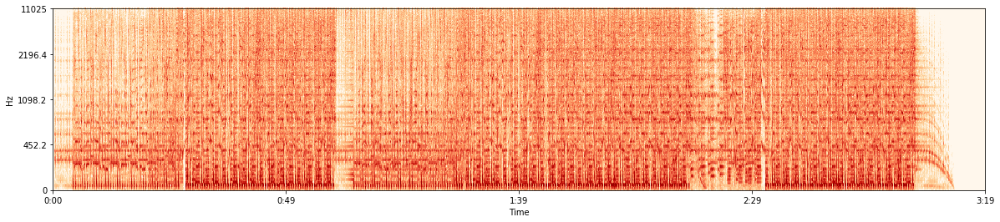

In [11]:
music, sr = librosa.load('music/call_me_maybe.mp3')
hop_length = 1024
n_fft = 2048
stft = librosa.stft(music, hop_length = hop_length, n_fft = n_fft)
log_spectrogram = librosa.logamplitude(np.abs(stft**2), ref_power=np.max)
audio(music, sr)

plt.figure(figsize=(20, 4))
librosa.display.specshow(log_spectrogram, sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()

Visualized above is the log spectrogram for the song. We are going to call this something more general for the purposes of this assignment. The log spectrogram is a sequence of *feature vectors*. Features are the same thing as frequency components, spectra, etc. The feature vector in this case are the numbers along each column of the log spectrogram. The sequence part is these features going forward in time. In this case, here's what we are dealing with:

M: 1025, N: 4296


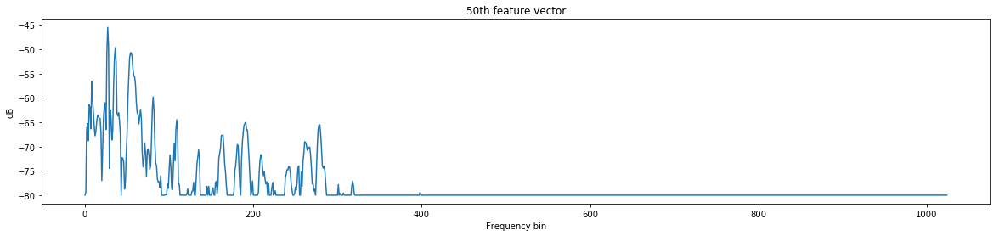

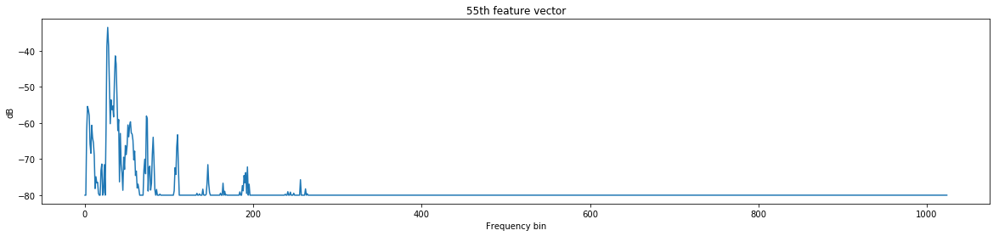

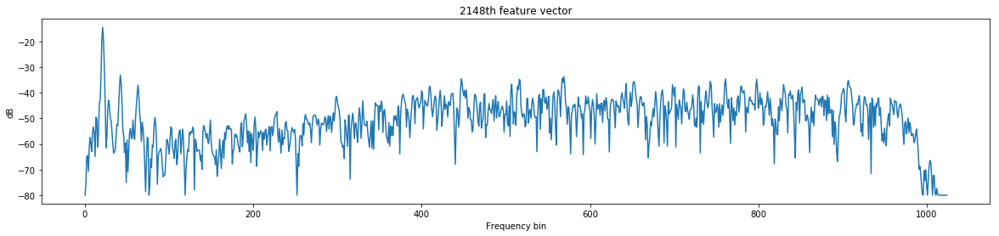

In [29]:
print 'M: %d, N: %d' % log_spectrogram.shape


def plot_feature_vector(log_spectrogram, index, hop_length, sr):
    plt.figure(figsize=(20, 4))
    plt.plot(log_spectrogram[:, int(index)])
    plt.title('%dth feature vector' % int(index))
    plt.ylabel('dB')
    plt.xlabel('Frequency bin')
    plt.show()

    audio(music[index*hop_length - int(sr*.5):index*hop_length + int(sr*.5)], sr)

plot_feature_vector(log_spectrogram, 50, hop_length, sr)
plot_feature_vector(log_spectrogram, 55, hop_length, sr)
plot_feature_vector(log_spectrogram, log_spectrogram.shape[1]/2, hop_length, sr)


M features in each vector in a sequence of N feature vectors. Feature vectors looks like the plots above. The audio around the feature vector is below each plot. Now consider the feature vectors above. How similar do they sound? What distance measures could you use to compare the feature vectors? List at least three. For each distance measure, define it in mathematical terms and explain how your choice of distance measure relates to your perception of similarity.

*(hint: check out https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.pdist.html for some different distance measures - we recommend at least looking at cosine and euclidean)*

**YOUR ANSWER GOES HERE**

Alright, time to make a similarity matrix!

In [8]:
## YOUR ANSWER GOES HERE

def sim_matrix(feature_vectors, sample_rate, hop_length, distance_metric = 'cosine', display = True):
    """
        Input:
            feature_vectors - a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence.
            sample_rate - sample rate of the original audio
            hop_length - the length of the hop used in the representation
            distance_metric - which distance metric to use to compute similarity. Defaults to cosine.
            display - whether or not to display the similarity matrix after computing it. Defaults to True.
        Output:
            if display is True, plot the similarity matrix. Along the x and y axis of the similarity matrix, 
            the ticks should be in seconds not in samples. 
            returns sim_matrix - an NxN matrix with the pairwise distance between every feature vector.
    """

For each distance measure you defined above, compute and display the self-similarity matrix.

In [ ]:
## YOUR ANSWER GOES HERE

**Interpreting the similarity matrix**

1. What does the main long diagonal going across each similarity matrix from top left to bottom right mean?
2. How can the blocky structures in the similarity matrix be interpreted? 
3. How are repeating patterns encoded in the similarity matrix?
4. How can edge structures in the similarity matrix be interpreted?
5. How did your distance measure affect your ability to find repetition, homogeneity, and novelty in the similarity matrix?

Think in terms of repetition, homogeneity, and novelty.

**YOUR ANSWER GOES HERE**

Going forward, based on your answer to the 5th part of the question above, pick one distance measure to use for the rest of this part of the assignment.

**Using different features**

Let's compute a similarity matrix from a different feature vector. Use [librosa.feature.mfcc](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html) and [librosa.feature.chroma_stft](https://librosa.github.io/librosa/generated/librosa.feature.chroma_stft.html). Compute and display similarity matrices for both of these with your chosen distance measure.

In [37]:
## YOUR ANSWER GOES HERE

1. How do your choice of features affect the similarity matrix?
2. Looking at the similarity matrix, what is similarity in this specific song dominated by?

**YOUR ANSWER GOES HERE**

<div class="alert alert-success">
<b>2. (5 points): Building an infinite jukebox using self-similarity with beat synchronous features</b>
</div>

In this part, we will learn how to extract beat synchronous features from a song. These features will be plugged into a similarity matrix to create a version of the [Infinite Jukebox](http://labs.echonest.com/Uploader/index.html?trid=TRORQWV13762CDDF4C).

In the previous part, we created self-similarity matrices from the STFT, the MFCC-gram, and the Chromagram. One issue with each of these is that the similarity measure is done at the level of the frame, rather than at the level of a meaningful musical structure. In this part, we instead consider self-similarity at the "beat" level, by using the beat tracker from librosa.

To make features beat synchronous, there are a couple things you should do:

1. Get the features (let's use librosa.feature.chroma_stft to get them).
2. Get the beats (let's use librosa.beat.beat_track for that).
3. For every feature vector between beat boundaries, you need a way to aggregate them into a single column. We'll examine the effect of different aggregators for beat synchronous features below. The idea is to take the chunk of feature vectors within a beat and aggregate them into a single feature vector using something like np.median, np.mean, np.max, np.sum.

Write code to do this below.

In [94]:
### YOUR ANSWER GOES HERE

def beat_track(music, sr, hop_length):
    """
        input: 
            music: an audio signal, single channel array containing all the samples of the signal.
            sr: sample rate to use
            hop_length: the hop length for the stft - without specifying this, the frames output by the beat tracker 
            may not match your feature vector sequence.
        output:
            beats: a list of all the frame indices found by the beat tracker
    """

def beat_sync_features(feature_vectors, beats, aggregator = np.median, display = True):
    """
        input:
            feature_vectors: a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence.
            beats: frames given by the beat tracker
            aggregator: how to summarize all the frames within a beat (e.g. np.median, np.mean). Defaults to np.median.
            display: if True, displays the beat synchronous features.
        output:
            beat_synced_features: a numpy ndarray MxB, where M is the number of features in each vector
            and B is the number of beats. Each column of this matrix represents a beat synchronous feature
            vector.
    """

Below, extract chroma features from the music. Then beat track the music and create and display beat synchronous feature vector sequences using three different aggregators.

In [100]:
### YOUR ANSWER GOES HERE

Based on your results above, pick one of the aggregators and justify its use.

**YOUR ANSWER GOES HERE**

Below, show the similarity matrix for your beat synchronous features with your chosen aggregator and chosen distance metric.

In [1]:
## YOUR ANSWER GOES HERE

Now, we're ready to put together an infinite jukebox! The infinite jukebox works by using the beat-synchronous self-similarity matrix to hop to different beats that are very similar to the upcoming beat with some probability. Given a good similarity measure and a good beat tracker, when the song jumps from beat to beat you shouldn't really notice it happening! Here's the pseudocode:

1. Extract the regular features (not beat synchronous).
2. Extract the beats using the beat tracker.
3. Aggregate the features into beat synchronous features.
4. Compute the beat synchronous self-similarity matrix.
5. Initialize the output of the jukebox.
5. Starting at the 1st beat, with some probability either pick the next beat in the song and tack it onto the jukebox output OR pick something very similar to the next beat in the song using the beat synchronous self-similarity matrix. This other beat could be anywhere in the song. Make sure not to jump to the beat you're on or you'll get stuck in a loop!
6. Repeat until your computer dies (or until you've exceeded the desired length).

In [234]:
## YOUR ANSWER GOES HERE
def get_music_samples(music, hop_length, start_frame, end_frame):
    """
        input:
            music - vector of samples for the musical signal - output by librosa.
            hop_length - hop_length for the feature vector computation
            start_frame - frame index to start at
            end_frame - frame index to end at
        output:
            chunk - samples corresponding to between and including the start and end frame
    """
    chunk = music[start_frame * hop_length: end_frame * hop_length]
    return chunk

def compute_beat_sync_chroma(music, sr, hop_length):
    """
        input:
            music - vector of samples for the musical signal - output by librosa.
            sr - sample rate for the audio
            hop_length - hop_length for the feature vector computation
        output: 
            beat_synced_features - beat synchronous chroma features for the signal
    """

def infinite_jukebox(music, sr,  hop_length, branching_probability, threshold, output_length):
    """
        input:
            music - vector of samples for the musical signal - output by librosa.
            sr - sample rate for the audio
            hop_length - hop_length for the feature vector computation
            branching_probability - how likely are we to pick the next beat? If its high, we never pick the next beat.
            If it is 0, we just end up getting the song back in the same order.
            threshold - what is the threshold of similarity for jumping to a new beat?
            output_length - how long do you want the output of your infinite jukebox to be? It unfortunately cannot
            actually be infinite. :(
        output:
            jukebox_output - vector of samples of length output_length * sr containing the results of your code.
    """

Below, run your jukebox! Play with the similarity threshold and the branching probability. Show us some variants. Keep the examples somewhat short (like 2 minutes tops). Have fun!

In [204]:
## YOUR ANSWER GOES HERE

<div class="alert alert-success">
<b>3. (5 points): Cross similarity: comparing songs using beat synchronous features</b>
</div>

We've looked now at self-similarity within a single song. We can extend these concepts to define song similarity - the similarity between two different songs. We can then use the similarity measure for cover song identification. Let's look at the following cover of Call Me Maybe.

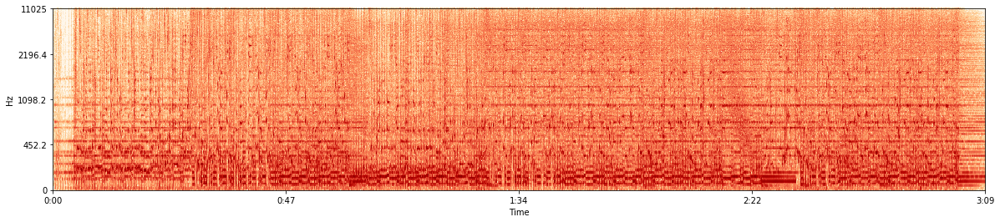

In [304]:
cover, sr = librosa.load('music/call_me_maybe_cover.mp3', offset = 40, duration = 190)
hop_length = 1024
n_fft = 2048
stft = librosa.stft(cover, hop_length = hop_length, n_fft = n_fft)
log_spectrogram = librosa.logamplitude(np.abs(stft**2), ref_power=np.max)
audio(cover, sr)

plt.figure(figsize=(20, 4))
librosa.display.specshow(log_spectrogram, sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()

In the space below, list all of the things you notice that are different between the cover and the original. What changed? When doing song similarity, we want to be robust to these changes. What changes will the beat synchronous chroma features we've been using so far be robust to, and what changes will it not be robust to?

**YOUR ANSWER GOES HERE**

Below, alter your earlier sim_matrix function to become a cross_sim_matrix function. cross_sim_matrix computes cross-similarity between two sets of feature vectors rather than self-similarity within a single feature vector.

In [227]:
## YOUR ANSWER GOES HERE

def cross_sim_matrix(feature_vectors_a, feature_vectors_b, sample_rate, hop_length, distance_metric = 'cosine', display = True):
    """
        Input:
            feature_vectors_a - a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence. Corresponds to the reference song.
            feature_vectors_b - a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence. Corresponds to the cover song.
            sample_rate - sample rate of the original audio
            hop_length - how many samples are in each frame
            distance_metric - which distance metric to use to compute similarity. Defaults to cosine.
            display - whether or not to display the similarity matrix after computing it. Defaults to True.
        Output:
            if display is True, plot the similarity matrix. Along the x and y axis of the similarity matrix, 
            the ticks should be in seconds not in samples. 
            returns cross_sim_matrix - an NxN matrix with the pairwise distance between every feature vector.
    """

Now, compute the beat synchronous features for both the cover and the reference, and their cross similarity matrix.

In [9]:
## YOUR ANSWER GOES HERE
song_chroma = "fill me in"
cover_chroma = "fill me in"

How'd it look? Not very similar, I bet. Why? Well looking at the beat synchronous chroma features, it should be clear that the two songs are in different keys. When you try to do the distance computation on each chroma feature vector, it will fail because the energy is in different bins! Now we'll write code to fix this and compute a proper cross-similarity measure. 

We can fix this by transposing one of the chromagrams so that the two songs are compared within the same key. Below, write some code to tranpose a chromagram by an arbitrary number of half steps. Rows of the chromagram should shift up or down by however many half steps. Rows at the top will wrap around to the bottom.

*Hint: np.roll is useful!*

In [270]:
## YOUR ANSWER GOES HERE

def transpose_chromagram(chroma, n_steps, display = True):
    """
        input: 
            chroma - 12xN numpy array. 
            n_steps - how many half steps to transpose by
            display - show the transposed chromagram
        output: a transposed version of the chroma
    """
    transposed_chroma = "fill this line in"#
    
    if display:
        plt.figure(figsize=(20, 12))
        plt.imshow(transposed_chroma, aspect = 3)
        plt.show()

Use the code below to find the optimal transposition (the actual number of half steps between the cover and the song) by looking at the cross-similarity matrices.

In [ ]:
for n_step in range(12):  
    print n_step
    tp_cover_chroma = transpose_chromagram(cover_chroma, n_step)
    song_chroma = transpose_chromagram(song_chroma, 0)
    csm = cross_sim_matrix(song_chroma, tp_cover_chroma, sr, hop_length, distance_metric = 'euclidean')

Once you've got the optimal transposition index, run the following:

In [5]:
n_step = '?? fill me in'
tp_cover_chroma = transpose_chromagram(cover_chroma, n_step)
song_chroma = transpose_chromagram(song_chroma, 0)
csm = cross_sim_matrix(song_chroma, tp_cover_chroma, sr, hop_length, distance_metric = 'correlation')

Switching the distance metric from euclidean to correlation distance is helpful - the two songs have different loudness characteristics.

Finally, let's make a version of the Infinite Jukebox that jumps between the song and its cover! What it should do is use the cross-similarity matrix to hop between the song and the cover. Everything else is the same as the regular infinite jukebox, but you'll want to toggle between jumping from song to cover and cover to song, depending on where you are. Have fun!

In [ ]:
## YOUR ANSWER GOES HERE
    
def cover_infinite_jukebox(song, cover, sr, hop_length, branching_probability, threshold, output_length):
    """
        input:
            song - vector of samples for the original song - output by librosa.
            cover - vector of samples for the cover song - output by librosa
            sr - sample rate for the audio
            hop_length - hop_length for the feature vector computation
            branching_probability - how likely are we to pick the next beat? If its high, we never pick the next beat.
            If it is 0, we just end up getting the song back in the same order.
            threshold - what is the threshold of similarity for jumping to a new beat?
            output_length - how long do you want the output of your infinite jukebox to be? It unfortunately cannot
            actually be infinite. :(
        output:
            jukebox_output - vector of samples of length output_length * sr containing the results of your code.
    """

Below, show a couple variants of the cover_infinite_jukebox with different branching probabilities and threshold, like you did before.

In [6]:
## YOUR ANSWER GOES HERE

And we're done! Zip it up and turn it in.